# COMPAS Score

El sistema COMPAS (Correctional offender management profiling for alternative sanctions) se usa en varios estados de los Estados Unidos para hacer una evaluación del riesgo de reincidencia de las personas detenidas.

En este caso, proporciona un conjunto de datos en bruto con información de las evaluaciones (fichero compas-scores.csv) y la historia legal de unos 11 000 casos en los años 2013 y 2014 (se trata de uno de los ficheros originales utilizados en un análisis independiente del sistema COMPAS llevado a cabo por ProPublica, disponible en internet).

Aunque el conjunto de datos contiene información adicional, para resolver las cuestiones planteadas en este caso son necesarios (aparte de algunos campos cuyo nombre es autoexplicativo) los siguientes campos:

- **“compas_screening_date”:** se refiere a la fecha en la que se realizó la evaluación.
- **“decile_score”:** es un número, de 1 a 10 que indica el riesgo de reincidencia en general (a mayor riesgo, mayor número).
- **“v_decile_score”:** es un número de 1 a 10, potencialmente distinto del anterior, que indica el riesgo de reincidencia en delitos violentos. Al hacer la evaluación de un caso en COMPAS, se generan las dos puntuaciones (entre otras cosas).
- **“is_recid”:** indicación de si la persona es reincidente (en el tiempo en que se recogen datos: no hay información de si la persona es reincidente más allá de ciertas fechas, y es importante tener esto en cuenta para asegurarse de hacer comparaciones homogéneas).
- **r_offense_date”:** fecha en la que se cometió el delito por el que se considera reincidente a la persona.“r_offense_date”: fecha en la que se cometió el delito por el que se considera reincidente a la persona.
- **“is_violent_recid”:** indicación de si la persona es reincidente en un delito con violencia (las mismas consideraciones sobre fechas que para “is_recid” aplican aquí)".
- **“vr_offense_date”:** fecha en la que se cometió el delito violento que da lugar a la consideración de reincidente.

In [1]:
import pandas as pd
import numpy as np
import altair as alt
from sklearn import metrics
from sklearn.metrics import roc_auc_score

In [2]:
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

## Análisis exploratorio y evaluación de calidad

Cargar los datos y realizar un análisis exploratorio y una evaluación de la calidad de los datos necesarios para el resto del caso. Específicamente, evaluar la integridad, validez y actualidad de los datos y proponer estrategias de mitigación de los posibles problemas encontrados.

In [3]:
# Leer los datos.
compas = pd.read_csv('compas-scores.csv')

In [4]:
# Seleccionar las columnas que se utilizarán.
compas = compas[["id", "name", "dob", "compas_screening_date", "decile_score", "v_decile_score", "is_recid", "r_offense_date", "is_violent_recid", "vr_offense_date", "sex", "race"]]

In [5]:
compas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11757 entries, 0 to 11756
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   id                     11757 non-null  int64 
 1   name                   11757 non-null  object
 2   dob                    11757 non-null  object
 3   compas_screening_date  11757 non-null  object
 4   decile_score           11757 non-null  int64 
 5   v_decile_score         11757 non-null  int64 
 6   is_recid               11757 non-null  int64 
 7   r_offense_date         3703 non-null   object
 8   is_violent_recid       11757 non-null  int64 
 9   vr_offense_date        882 non-null    object
 10  sex                    11757 non-null  object
 11  race                   11757 non-null  object
dtypes: int64(5), object(7)
memory usage: 1.1+ MB


In [6]:
compas.describe()

,id,decile_score,v_decile_score,is_recid,is_violent_recid
count,11757.000000,11757.000000,11757.000000,11757.000000,11757.000000
mean,5879.000000,4.371268,3.571489,0.253806,0.075019
std,3394.097892,2.877598,2.500479,0.558324,0.263433
min,1.000000,-1.000000,-1.000000,-1.000000,0.000000
25%,2940.000000,2.000000,1.000000,0.000000,0.000000
50%,5879.000000,4.000000,3.000000,0.000000,0.000000
75%,8818.000000,7.000000,5.000000,1.000000,0.000000
max,11757.000000,10.000000,10.000000,1.000000,1.000000


In [7]:
compas.describe(include='object')

,name,dob,compas_screening_date,r_offense_date,vr_offense_date,sex,race
count,11757,11757,11757,3703,882,11757,11757
unique,11584,7800,704,1090,599,2,6
top,robert taylor,1991-08-12,2013-03-20,2014-12-08,2015-08-15,Male,African-American
freq,4,6,39,12,6,9336,5813


In [8]:
compas.head(10)

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaN,0,NaN,Male,Other
1,2,michael ryan,1985-02-06,2014-12-31,5,2,-1,NaN,0,NaN,Male,Caucasian
2,3,kevon dixon,1982-01-22,2013-01-27,3,1,1,2013-07-05,1,2013-07-05,Male,African-American
3,4,ed philo,1991-05-14,2013-04-14,4,3,1,2013-06-16,0,NaN,Male,African-American
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaN,0,NaN,Male,African-American
5,6,bouthy pierrelouis,1973-01-22,2013-03-26,1,1,0,NaN,0,NaN,Male,Other
6,7,marsha miles,1971-08-22,2013-11-30,1,1,0,NaN,0,NaN,Male,Other
7,8,edward riddle,1974-07-23,2014-02-19,6,2,1,2014-03-31,0,NaN,Male,Caucasian
8,9,steven stewart,1973-02-25,2013-08-30,4,3,0,NaN,0,NaN,Male,Other
9,10,elizabeth thieme,1976-06-03,2014-03-16,1,1,0,NaN,0,NaN,Female,Caucasian


In [9]:
# Convertir fechas a datetime
fechas = compas[["dob", "compas_screening_date", "r_offense_date", "vr_offense_date"]]
for field in fechas:
    compas[field] = pd.to_datetime(compas[field])

# Convertir datos categóricos
categorias = compas[["sex", "decile_score", "v_decile_score", "race", "is_recid", "is_violent_recid"]]
for field in categorias:
    compas[field] = compas[field].astype('category')
    
# Comprobar cambio
compas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11757 entries, 0 to 11756
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   id                     11757 non-null  int64         
 1   name                   11757 non-null  object        
 2   dob                    11757 non-null  datetime64[ns]
 3   compas_screening_date  11757 non-null  datetime64[ns]
 4   decile_score           11757 non-null  category      
 5   v_decile_score         11757 non-null  category      
 6   is_recid               11757 non-null  category      
 7   r_offense_date         3703 non-null   datetime64[ns]
 8   is_violent_recid       11757 non-null  category      
 9   vr_offense_date        882 non-null    datetime64[ns]
 10  sex                    11757 non-null  category      
 11  race                   11757 non-null  category      
dtypes: category(6), datetime64[ns](4), int64(1), object(1)
memor

In [10]:
compas.head()

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaT,0,NaT,Male,Other
1,2,michael ryan,1985-02-06,2014-12-31,5,2,-1,NaT,0,NaT,Male,Caucasian
2,3,kevon dixon,1982-01-22,2013-01-27,3,1,1,2013-07-05,1,2013-07-05,Male,African-American
3,4,ed philo,1991-05-14,2013-04-14,4,3,1,2013-06-16,0,NaT,Male,African-American
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaT,0,NaT,Male,African-American


### Integridad

**Ausencia de “huecos” en los  datos.**

Como vimos anteriormente al imprimir la información del dataset, hay 2 campos que tienen valores nulos: r_offense_date y vr_offense_date. Vamos a visualizar los registros con valores nulos para ver cómo se pueden mitigar o si significan algo.

Se inicia con la variable r_offense_date, para ello filtramos el dataset para ver el comportamiento de todos los registros que tengan este campo nulo.

In [11]:
compas[compas.r_offense_date.isnull()]

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaT,0,NaT,Male,Other
1,2,michael ryan,1985-02-06,2014-12-31,5,2,-1,NaT,0,NaT,Male,Caucasian
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaT,0,NaT,Male,African-American
5,6,bouthy pierrelouis,1973-01-22,2013-03-26,1,1,0,NaT,0,NaT,Male,Other
6,7,marsha miles,1971-08-22,2013-11-30,1,1,0,NaT,0,NaT,Male,Other
...,...,...,...,...,...,...,...,...,...,...,...,...
11750,11751,carlos vasquez,1971-11-04,2014-03-04,1,1,0,NaT,0,NaT,Male,Hispanic
11752,11753,patrick hamilton,1968-05-02,2013-09-22,3,1,0,NaT,0,NaT,Male,Other
11754,11755,dieuseul pierre-gilles,1981-01-24,2014-10-08,4,3,0,NaT,0,NaT,Male,Other
11755,11756,scott lomagistro,1986-12-04,2013-12-03,3,2,0,NaT,0,NaT,Male,Caucasian


Se observa que es normal que hayan datos de r_offense_date como nulos cuando las personas retenidas no son reincidentes (is_recid = 0) o no se posee información clara de ello (is_recid = -1). Por ende, no se considera que haya un problema de integridad con este campo.

Ahora se pasa a analizar el campo vr_offense_date, para ello filtramos el dataset para ver el comportamiento de todos los registros que tengan este campo nulo.

In [12]:
compas[compas.vr_offense_date.isnull()]

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaT,0,NaT,Male,Other
1,2,michael ryan,1985-02-06,2014-12-31,5,2,-1,NaT,0,NaT,Male,Caucasian
3,4,ed philo,1991-05-14,2013-04-14,4,3,1,2013-06-16,0,NaT,Male,African-American
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaT,0,NaT,Male,African-American
5,6,bouthy pierrelouis,1973-01-22,2013-03-26,1,1,0,NaT,0,NaT,Male,Other
...,...,...,...,...,...,...,...,...,...,...,...,...
11752,11753,patrick hamilton,1968-05-02,2013-09-22,3,1,0,NaT,0,NaT,Male,Other
11753,11754,raymond hernandez,1993-06-24,2013-05-17,7,5,1,2014-10-11,0,NaT,Male,Caucasian
11754,11755,dieuseul pierre-gilles,1981-01-24,2014-10-08,4,3,0,NaT,0,NaT,Male,Other
11755,11756,scott lomagistro,1986-12-04,2013-12-03,3,2,0,NaT,0,NaT,Male,Caucasian


In [13]:
compas[compas.is_violent_recid!=0].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 882 entries, 2 to 11737
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   id                     882 non-null    int64         
 1   name                   882 non-null    object        
 2   dob                    882 non-null    datetime64[ns]
 3   compas_screening_date  882 non-null    datetime64[ns]
 4   decile_score           882 non-null    category      
 5   v_decile_score         882 non-null    category      
 6   is_recid               882 non-null    category      
 7   r_offense_date         882 non-null    datetime64[ns]
 8   is_violent_recid       882 non-null    category      
 9   vr_offense_date        882 non-null    datetime64[ns]
 10  sex                    882 non-null    category      
 11  race                   882 non-null    category      
dtypes: category(6), datetime64[ns](4), int64(1), object(1)
memory 

Se observa que es normal que hayan datos de vr_offense_date como nulos cuando las personas retenidas no son reincidentes con un caso de violencia (is_violent_recid = 0). Por lo tanto no se considera que este campo tenga un problema de integridad.

### Validez

**La validez de los datos hace referencia a que estos sigan las reglas y la sintaxis definidas para ellos.**

Al hacer la conversión de datos de los campos de fecha, se validó que se podían convertir, por lo tanto estos campos no tienen problemas de validez. Ahora se procederá a comprobar qué valores tienen las columnas categóricas.

In [14]:
def validar_cat():
    for field in categorias:
        print('------ '+field+' ------')
        print(compas[field].value_counts())

In [15]:
validar_cat()

------ sex ------
Male      9336
Female    2421
Name: sex, dtype: int64
------ decile_score ------
1     2577
2     1572
3     1259
4     1199
5     1034
6      993
7      900
9      802
8      796
10     610
-1      15
Name: decile_score, dtype: int64
------ v_decile_score ------
1     3359
2     1789
3     1581
4     1239
5     1083
6      919
7      666
8      476
9      440
10     200
-1       5
Name: v_decile_score, dtype: int64
------ race ------
African-American    5813
Caucasian           4085
Hispanic            1100
Other                661
Asian                 58
Native American       40
Name: race, dtype: int64
------ is_recid ------
0     7335
1     3703
-1     719
Name: is_recid, dtype: int64
------ is_violent_recid ------
0    10875
1      882
Name: is_violent_recid, dtype: int64


Para este caso, se puede observar claramente que los campos decile_score y v_decile_score tienen valores del -1 al 10, de los cuales el -1 no se considera un valor válido. El campo is_recid tiene 3 valores -1, 1 y 0, de los cuales deberían ser válidos sólo 1 y 0 (verdadero o falso) ya que son los que proporcionan información válida. 

Por eso para efectos de este análisis, se filtrarán todos los registros correspondientes a decile_score = -1, v_decile_score = -1 y is_recid = -1.

In [16]:
compas = compas[compas.is_recid!=-1]
compas = compas[compas.decile_score!=-1]
compas = compas[compas.v_decile_score!=-1]

compas.is_recid.cat.remove_unused_categories(inplace=True)
compas.decile_score.cat.remove_unused_categories(inplace=True)
compas.v_decile_score.cat.remove_unused_categories(inplace=True)

compas

/var/folders/vv/lnb2bzhx2tl8wlxtnsb00p7w0000gn/T/ipykernel_28539/3464629087.py:5: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  compas.is_recid.cat.remove_unused_categories(inplace=True)
/var/folders/vv/lnb2bzhx2tl8wlxtnsb00p7w0000gn/T/ipykernel_28539/3464629087.py:6: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  compas.decile_score.cat.remove_unused_categories(inplace=True)
/var/folders/vv/lnb2bzhx2tl8wlxtnsb00p7w0000gn/T/ipykernel_28539/3464629087.py:7: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  compas.v_decile_score.cat.remove_unused_categories(inplace=True)


,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaT,0,NaT,Male,Other
2,3,kevon dixon,1982-01-22,2013-01-27,3,1,1,2013-07-05,1,2013-07-05,Male,African-American
3,4,ed philo,1991-05-14,2013-04-14,4,3,1,2013-06-16,0,NaT,Male,African-American
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaT,0,NaT,Male,African-American
5,6,bouthy pierrelouis,1973-01-22,2013-03-26,1,1,0,NaT,0,NaT,Male,Other
...,...,...,...,...,...,...,...,...,...,...,...,...
11752,11753,patrick hamilton,1968-05-02,2013-09-22,3,1,0,NaT,0,NaT,Male,Other
11753,11754,raymond hernandez,1993-06-24,2013-05-17,7,5,1,2014-10-11,0,NaT,Male,Caucasian
11754,11755,dieuseul pierre-gilles,1981-01-24,2014-10-08,4,3,0,NaT,0,NaT,Male,Other
11755,11756,scott lomagistro,1986-12-04,2013-12-03,3,2,0,NaT,0,NaT,Male,Caucasian


### Actualidad

**Datos suficientemente recientes.**

Como se puede ver el conjunto de datos tiene los siguiented rangos de fecha:

In [17]:
# compas_screening_date

print(f'De: {compas.compas_screening_date.min()} A: {compas.compas_screening_date.max()}')

De: 2013-01-01 00:00:00 A: 2014-12-31 00:00:00


In [18]:
# r_offense_date

print(f'De: {compas.r_offense_date.min()} A: {compas.r_offense_date.max()}')

De: 2013-01-03 00:00:00 A: 2016-03-29 00:00:00


In [19]:
# vr_offense_date

print(f'De: {compas.vr_offense_date.min()} A: {compas.vr_offense_date.max()}')

De: 2013-01-28 00:00:00 A: 2016-03-13 00:00:00


In [20]:
alt.Chart(compas, height = 300, width = 320).mark_bar()\
    .encode(alt.X(alt.repeat("column"),type='temporal'), y='count()',
           tooltip = [alt.Tooltip(alt.repeat("column"), type="temporal")])\
    .repeat(column=['compas_screening_date','r_offense_date','vr_offense_date'])\
    .interactive()

alt.RepeatChart(...)

Se puede observar que el conjunto de datos se evaluó entre el 2013 y el 2014, y que se tienen datos sobre reinidencias hasta marzo del 2016. Esto puede representar un problema de actualidad, ya que no se poseen datos de reincidencias posteriores a estos y además, si intentamos tomar en cuenta los mismos datos para realizar un análisis de la actualidad, no funcionaría correctamente.

### Otras validaciones de calidad

Adicionalmente, luego de hacer todo este filtrado, comprobamos si existen duplicados en el dataset, para ello, tomaremos como llave el nombre y la fecha de nacimiento de la persona.

In [21]:
compas[compas.duplicated(subset=['name','dob'], keep=False)].sort_values(by=['name'])

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race


En este punto de nuestro análisis, no existen registros duplicados.

## Feature Engineering

**¿Son los campos “is_recid” e “is_violent_recid” en este conjunto de datos adecuados para evaluar la precisión de las estimaciones de riesgo generadas por el sistema COMPAS? Si no es así, definir y calcular una feature que sí lo sea.**

Como observamos antes, el conjunto de datos tiene problemas de actualidad, ya que hay evaluaciones hasta el 2014, y reincidencias hasta el 2016. Sería incorrecto tomar en cuenta valores para los cuales no haya pasado suficiente tiempo para validar si es reincidente o no. Por esto, filtraremos por las fechas correctas de forma que este problema no afecte nuestro análisis. De no hacerlo, estaríamos haciendo un análisis desproporcionado entre los reincidentes y los no reincidentes.

Se crearán dos campos para validar el tiempo transcurrido entre la fecha de la evaluación y cada una de las fechas de ofensa en años.

In [22]:
compas['days_until_offense'] = (compas.r_offense_date - compas.compas_screening_date).dt.days/365
compas['days_until_v_offense'] = (compas.vr_offense_date - compas.compas_screening_date).dt.days/365

compas

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race,days_until_offense,days_until_v_offense
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaT,0,NaT,Male,Other,NaN,NaN
2,3,kevon dixon,1982-01-22,2013-01-27,3,1,1,2013-07-05,1,2013-07-05,Male,African-American,0.435616,0.435616
3,4,ed philo,1991-05-14,2013-04-14,4,3,1,2013-06-16,0,NaT,Male,African-American,0.172603,NaN
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaT,0,NaT,Male,African-American,NaN,NaN
5,6,bouthy pierrelouis,1973-01-22,2013-03-26,1,1,0,NaT,0,NaT,Male,Other,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11752,11753,patrick hamilton,1968-05-02,2013-09-22,3,1,0,NaT,0,NaT,Male,Other,NaN,NaN
11753,11754,raymond hernandez,1993-06-24,2013-05-17,7,5,1,2014-10-11,0,NaT,Male,Caucasian,1.402740,NaN
11754,11755,dieuseul pierre-gilles,1981-01-24,2014-10-08,4,3,0,NaT,0,NaT,Male,Other,NaN,NaN
11755,11756,scott lomagistro,1986-12-04,2013-12-03,3,2,0,NaT,0,NaT,Male,Caucasian,NaN,NaN


Para seleccionar el periodo de tiempo que se utilizará en este análisis, se utilizó como referencia la descripción oficial del conjunto de datos, donde se explica que se tomó en cuenta la reincidencia para un periodo de 2 años luego de su fecha de evaluación.

https://www.propublica.org/article/how-we-analyzed-the-compas-recidivism-algorithm

Por eso, se crearán dos features adicionales (una para ofensas normales y otra para ofensas violentas), donse se asignará 1 si los días antes de la ofensa son menores a 2 años, y, 0 si los valores son mayores a dos años o no reincidentes. De esta forma estaríamos contando como no reincidentes a aquellas personas cuyo ofensa ocurrió luego de dos años de su fecha de evaluación.

In [23]:
compas['is_recid_calc'] = np.where(((compas.is_recid==1) & (compas.days_until_offense<=2)),1,0)
compas['is_v_recid_calc'] = np.where(((compas.is_violent_recid==1) & (compas.days_until_v_offense<=2)),1,0)

compas

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race,days_until_offense,days_until_v_offense,is_recid_calc,is_v_recid_calc
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0
2,3,kevon dixon,1982-01-22,2013-01-27,3,1,1,2013-07-05,1,2013-07-05,Male,African-American,0.435616,0.435616,1,1
3,4,ed philo,1991-05-14,2013-04-14,4,3,1,2013-06-16,0,NaT,Male,African-American,0.172603,NaN,1,0
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaT,0,NaT,Male,African-American,NaN,NaN,0,0
5,6,bouthy pierrelouis,1973-01-22,2013-03-26,1,1,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11752,11753,patrick hamilton,1968-05-02,2013-09-22,3,1,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0
11753,11754,raymond hernandez,1993-06-24,2013-05-17,7,5,1,2014-10-11,0,NaT,Male,Caucasian,1.402740,NaN,1,0
11754,11755,dieuseul pierre-gilles,1981-01-24,2014-10-08,4,3,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0
11755,11756,scott lomagistro,1986-12-04,2013-12-03,3,2,0,NaT,0,NaT,Male,Caucasian,NaN,NaN,0,0


Podemos analizar los casos que fueron modificados según el criterio establecido, si creamos tablas cruzadas.

In [24]:
pd.crosstab(compas.is_recid,compas.is_recid_calc)

is_recid_calc,0,1
is_recid,,
0,7326,0
1,278,3423


In [25]:
pd.crosstab(compas.is_violent_recid,compas.is_v_recid_calc)

is_v_recid_calc,0,1
is_violent_recid,,
0,10145,0
1,113,769


De aquí en adelante, la idea es trabajar el análisis con las nuevas features generadas que definen si es reincidente en un plazo de dos años. Sin embargo, no se filtra el dataframe para poder utilizar como comparación los valores anteriores en caso de ser necesario.

## Tabla de contingencia

**Una tabla en la que se muestran los acumulados de cada combinación de valores predichos y valores reales se denomina "tabla de contingencia". A continuación se puede visualizar un ejemplo:**

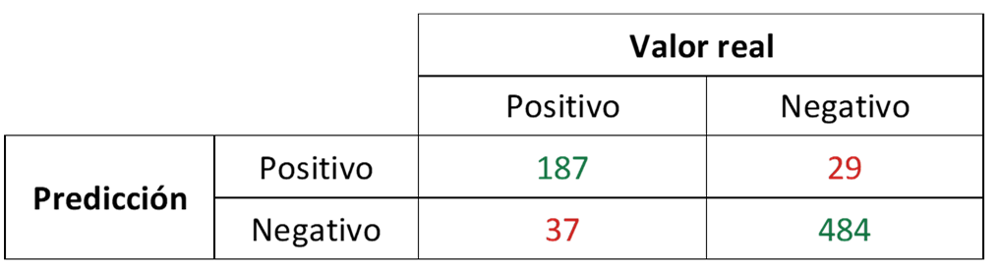


Para este ejercicio el umbral para establecer medidas preventivas de la reincidencia es de 7 en adelante. Dado este umbral, generar una tabla de contingencia, explicando qué caso se considera como "positivo" (y, por lo tanto, cuáles son los errores de tipo I y los errores de tipo II).

In [26]:
umbral = 7

cat_mayores_umbral = list(range(umbral, 11))
cat_mayores_umbral

[7, 8, 9, 10]

Se crearán dos features adicionales, en las que se establecerá una predicción para ofensas violentas y no violentas, eniendo en cuenta este umbral establecido.

In [27]:
for val in cat_mayores_umbral:
    compas.loc[compas.decile_score == val, 'is_recid_pred'] = 1
    compas.loc[compas.v_decile_score == val, 'is_v_recid_pred'] = 1

compas.is_recid_pred = compas.is_recid_pred.fillna(0)
compas.is_v_recid_pred = compas.is_v_recid_pred.fillna(0)

compas.is_recid_pred = compas.is_recid_pred.astype(int)
compas.is_v_recid_pred = compas.is_v_recid_pred.astype('int')

compas.is_recid_pred = compas.is_recid_pred.fillna(0)
compas.is_v_recid_pred = compas.is_v_recid_pred.fillna(0)

compas

,id,name,dob,compas_screening_date,decile_score,v_decile_score,is_recid,r_offense_date,is_violent_recid,vr_offense_date,sex,race,days_until_offense,days_until_v_offense,is_recid_calc,is_v_recid_calc,is_recid_pred,is_v_recid_pred
0,1,miguel hernandez,1947-04-18,2013-08-14,1,1,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0,0,0
2,3,kevon dixon,1982-01-22,2013-01-27,3,1,1,2013-07-05,1,2013-07-05,Male,African-American,0.435616,0.435616,1,1,0,0
3,4,ed philo,1991-05-14,2013-04-14,4,3,1,2013-06-16,0,NaT,Male,African-American,0.172603,NaN,1,0,0,0
4,5,marcu brown,1993-01-21,2013-01-13,8,6,0,NaT,0,NaT,Male,African-American,NaN,NaN,0,0,1,0
5,6,bouthy pierrelouis,1973-01-22,2013-03-26,1,1,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11752,11753,patrick hamilton,1968-05-02,2013-09-22,3,1,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0,0,0
11753,11754,raymond hernandez,1993-06-24,2013-05-17,7,5,1,2014-10-11,0,NaT,Male,Caucasian,1.402740,NaN,1,0,1,0
11754,11755,dieuseul pierre-gilles,1981-01-24,2014-10-08,4,3,0,NaT,0,NaT,Male,Other,NaN,NaN,0,0,0,0
11755,11756,scott lomagistro,1986-12-04,2013-12-03,3,2,0,NaT,0,NaT,Male,Caucasian,NaN,NaN,0,0,0,0


Convertimos las últimas 4 features generadas en categóricas.

In [28]:
compas['is_recid_calc'] = compas['is_recid_calc'].astype('category')
compas['is_v_recid_calc'] = compas['is_v_recid_calc'].astype('category')
compas['is_recid_pred'] = compas['is_recid_pred'].astype('category')
compas['is_v_recid_pred'] = compas['is_v_recid_pred'].astype('category')

compas.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11027 entries, 0 to 11756
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   id                     11027 non-null  int64         
 1   name                   11027 non-null  object        
 2   dob                    11027 non-null  datetime64[ns]
 3   compas_screening_date  11027 non-null  datetime64[ns]
 4   decile_score           11027 non-null  category      
 5   v_decile_score         11027 non-null  category      
 6   is_recid               11027 non-null  category      
 7   r_offense_date         3701 non-null   datetime64[ns]
 8   is_violent_recid       11027 non-null  category      
 9   vr_offense_date        882 non-null    datetime64[ns]
 10  sex                    11027 non-null  category      
 11  race                   11027 non-null  category      
 12  days_until_offense     3701 non-null   float64       
 13  d

Ahora, se mostrarán las tablas de contigencia para las ofensas violentas y las no violentas, recordando que usaremos los campos calculados para evitar los problemas de actualidad del dataset.

Serán positivos los casos donde:

* Se prediga que la persona es reincidente (violenta o no) y realmente lo sea.
* Se prediga que la persona no es reincidente (violenta o no) y realmente no lo sea.

In [29]:
# No violentas
ct_no_v = pd.crosstab(compas.is_recid_pred, compas.is_recid_calc)
ct_no_v

is_recid_calc,0,1
is_recid_pred,,
0,6047,2019
1,1557,1404


In [30]:
# Valores de la tabla de contingencia para casos no violentos
verdaderos_positivos_no_v = ct_no_v[1][1]
verdaderos_negativos_no_v = ct_no_v[0][0]
falsos_positivos_no_v = ct_no_v[0][1]
falsos_negativos_no_v = ct_no_v[1][0]

print(verdaderos_positivos_no_v)
print(verdaderos_negativos_no_v)
print(falsos_positivos_no_v)
print(falsos_negativos_no_v)

1404
6047
1557
2019


Los errores que se pueden observar para los casos **no violentos** calculados anteriormente son los siguientes:

* **Falsos Positivos (Error de Tipo I):** 1557
* **Falsos Negativos (Error de Tipo II):** 2019

In [31]:
# Violentas
ct_v = pd.crosstab(compas.is_v_recid_pred, compas.is_v_recid_calc)
ct_v

is_v_recid_calc,0,1
is_v_recid_pred,,
0,8781,538
1,1477,231


In [32]:
# Valores de la tabla de contingencia para casos violentos
verdaderos_positivos_v = ct_v[1][1]
verdaderos_negativos_v = ct_v[0][0]
falsos_positivos_v = ct_v[0][1]
falsos_negativos_v = ct_v[1][0]

print(verdaderos_positivos_v)
print(verdaderos_negativos_v)
print(falsos_positivos_v)
print(falsos_negativos_v)

231
8781
1477
538


Los errores que se pueden observar para los casos **violentos** calculados anteriormente son los siguientes:

* **Falsos Positivos (Error de Tipo I):** 1477
* **Falsos Negativos (Error de Tipo II):** 538

Procedemos a calcular las métricas de clasificación binaria.

### Métricas de clasificación binaria

Se define un método que cree todos los cálculos.

In [33]:
def metricas (vp, vn, fp, fn):
    sensibilidad = round(vp / (vp + fn), 3) 
    especificidad = round(vn / (vn + fp), 3)
    tfp = round(fp / (fp + vn), 3)
    tfn = round(fn / (fn + vp), 3)
    precision = round(vp / (vp + fp), 3)
    exactitud = round((vp + vn)/(vp + fn + vn + fp), 3)
    f_score= round(2 * (precision * sensibilidad) / (precision + sensibilidad), 3)
    return sensibilidad, especificidad, tfp, tfn, precision, exactitud, f_score

Se calculan las métricas tanto como para casos de no violencia, como para casos de violencia.

In [34]:
# No violentos
sensibilidad_no_v, especificidad_no_v, tfp_no_v, tfn_no_v, precision_no_v, exactitud_no_v, f_score_no_v = metricas (verdaderos_positivos_no_v, verdaderos_negativos_no_v, falsos_positivos_no_v, falsos_negativos_no_v)

print(f'sensibilidad_no_v: {sensibilidad_no_v}')
print(f'especificidad_no_v: {especificidad_no_v}')
print(f'tfp_no_v: {tfp_no_v}')
print(f'tfn_no_v: {tfn_no_v}')
print(f'precision_no_v: {precision_no_v}')
print(f'exactitud_no_v: {exactitud_no_v}')
print(f'f_score_no_v: {f_score_no_v}')

sensibilidad_no_v: 0.41
especificidad_no_v: 0.795
tfp_no_v: 0.205
tfn_no_v: 0.59
precision_no_v: 0.474
exactitud_no_v: 0.676
f_score_no_v: 0.44


In [35]:
# Violentos
sensibilidad_v, especificidad_v, tfp_v, tfn_v, precision_v, exactitud_v, f_score_v = metricas (verdaderos_positivos_v, verdaderos_negativos_v, falsos_positivos_v, falsos_negativos_v)

print(f'sensibilidad_v: {sensibilidad_v}')
print(f'especificidad_v: {especificidad_v}')
print(f'tfp_v: {tfp_v}')
print(f'tfn_v: {tfn_v}')
print(f'precision_v: {precision_v}')
print(f'exactitud_v: {exactitud_v}')
print(f'f_score_v: {f_score_v}')

sensibilidad_v: 0.3
especificidad_v: 0.856
tfp_v: 0.144
tfn_v: 0.7
precision_v: 0.135
exactitud_v: 0.817
f_score_v: 0.186


## Evaluación gráfica de asignaciones de riesgo

**El sistema asigna, de media, evaluaciones de riesgo más altas a los hombres que a las mujeres, y a las personas de raza afroamericana que a las de raza caucásica. Sin embargo, también las tasas de reincidencia son más altas para esos colectivos, aunque no está claro que la asignación de riesgo sea “justa” o no. Mostrar estas diferencias mediante representaciones gráficas y utilizarlas para analizar si la asignación de evaluaciones es justa o no.**     

Primero podemos iniciar por hacer un análisis general para saber cuántos hombres y mujeres se evaluaron y pertenecientes a qué razas. Eso no significa necesariamente un sesgo, sino que puede ser un reflejo de la realidad, no hay manera de decirlo con precisión.

In [36]:
compas.groupby(['race', 'sex'])['id'].count().unstack(0)

race,African-American,Asian,Caucasian,Hispanic,Native American,Other
sex,,,,,,
Female,1048,5,916,168,10,116
Male,4450,48,2895,841,26,504


Ahora podemos hacer un análisis general de estas categorías y los puntajes asignados con una tabla agrupada y con gradientes donde el color más oscuro representa mayores cantidades de personas clasificadas en ese grupo.

In [37]:
# Puntajes asignados para casos no violentos
compas.groupby(['race', 'sex'])['decile_score'].value_counts(normalize=False).unstack(0).style.background_gradient()

In [38]:
# Puntajes asignados para casos violentos
compas.groupby(['race', 'sex'])['v_decile_score'].value_counts(normalize=False).unstack(0).style.background_gradient()

In [39]:
# Resultado obtenido en la práctica para casos no violentos.
compas.groupby(['race', 'sex'])['is_recid_calc'].value_counts(normalize=False).unstack(0).style.background_gradient()

In [40]:
# Resultado obtenido en la práctica para casos violentos.
compas.groupby(['race', 'sex'])['is_v_recid_calc'].value_counts(normalize=False).unstack(0).style.background_gradient()

### Evaluación de sexo

#### No violentos

A continuación, podemos ver la cantidad de asignaciones de los diferentes puntajes según el sexo de la persona evaluada, para así poder determinar si en efecto el sexo que tiene mayores puntajes es el masculino.

In [41]:
viz_is_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('decile_score:N', title = 'Recid Score'), 
                                 y = 'count(sex):Q',
                                 color = alt.Color('decile_score:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='sex:O')

viz_is_recid

alt.Chart(...)

Como podemos ver en las gráficas anteriores, el sexo con mayor cantidad de personas evaluadas es el masculino. Los cuales tienen mayor cantidad de valuados con puntajes mayores de posible reincidencia. Veamos a continuación si esto se cumple así en la práctica.

In [42]:
viz_is_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('is_recid_calc:N', title = 'Recid'), 
                                 y = 'count(sex):Q',
                                 color = alt.Color('is_recid_calc:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='sex:O')

viz_is_recid

alt.Chart(...)

Como se puede observar, en la práctica sí son las personas de sexo masculino las más reincidentes.s

#### Violentos

Ahora realizaremos la misma evaluación pero para reincidencias violentas. Iniciamos con los puntajes asignados y, posteriormente, con los resultados obtenidos en la vida real.

In [43]:
viz_is_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('v_decile_score:N', title = 'Recid Score'), 
                                 y = 'count(sex):Q',
                                 color = alt.Color('v_decile_score:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='sex:O')

viz_is_recid

alt.Chart(...)

In [44]:
viz_is_v_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('is_v_recid_calc:N', title = 'Violent R'), 
                                 y = 'count(sex):Q',
                                 color = alt.Color('is_v_recid_calc:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='sex:O')

viz_is_v_recid

alt.Chart(...)

Como se puede observar, el resultado es el mismo, en la práctica sí son las personas de sexo masculino las más reincidentes.

### Evaluación de raza

#### No violentos

A continuación, podemos ver la cantidad de asignaciones de los diferentes puntajes según la raza de la persona evaluada, para así poder determinar si en efecto la raza que tiene mayores puntajes es "African-American".

In [45]:
viz_is_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('decile_score:N', title = 'Recid Score'), 
                                 y = 'count(race):Q',
                                 color = alt.Color('decile_score:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='race:O')

viz_is_recid

alt.Chart(...)

Como podemos ver en las gráficas anteriores, las razas con mayor cantidad de personas evaluadas son "African-American" y "Caucasian". Sin embargo, sí hay mayor cantidad de "African-American" evaluados con puntajes mayores de posible reincidencia. Veamos a continuación si esto se cumple así en la práctica.

In [46]:
viz_is_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('is_recid_calc:N', title = 'Recid'), 
                                 y = 'count(race):Q',
                                 color = alt.Color('is_recid_calc:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='race:O')

viz_is_recid

alt.Chart(...)

Como se puede observar, en la práctica sí son los "African-American" los más reincidentes, seguidos por los "Caucasian".

#### Violentos

Ahora realizaremos la misma evaluación pero para reincidencias violentas. Iniciamos con los puntajes asignados y, posteriormente, con los resultados obtenidos en la vida real.

In [47]:
viz_is_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('v_decile_score:N', title = 'Recid Score'), 
                                 y = 'count(race):Q',
                                 color = alt.Color('v_decile_score:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='race:O')

viz_is_recid

alt.Chart(...)

In [48]:
viz_is_v_recid = alt.Chart(compas).mark_bar().encode(x = alt.X('is_v_recid_calc:N', title = 'Violent R'), 
                                 y = 'count(race):Q',
                                 color = alt.Color('is_v_recid_calc:N', scale=alt.Scale(scheme='bluepurple')),
                                 column='race:O')

viz_is_v_recid

alt.Chart(...)

Como se puede observar, el resultado es el mismo, en la práctica sí son los "African-American" los más reincidentes, seguidos por los "Caucasian".

## Capacidad predictiva

**¿Para qué tipo de riesgos, el de delitos generales o el de delitos violentos, tiene el sistema más capacidad predictiva?**

Para poder validar esto, se realizará el cálculo del área bajo la curva ROC que va de 0 a 1, sabiendo que mientras mayor sea el número, mayor será la capacidad de predicción del modelo

In [49]:
AUC_ROC_no_v = roc_auc_score((compas.is_recid_calc == 1), compas.is_recid_pred)
AUC_ROC_no_v

0.6027029341538496

In [50]:
AUC_ROC_v = roc_auc_score((compas.is_v_recid_calc == 1), compas.is_v_recid_pred)
AUC_ROC_v

0.5782024673691833

En ninguno de los dos casos el modelo es muy bueno, sin embargo, el modelo tiene más capacidad predictiva para los casos no violentos.